# Attentive Image Captioning

This notebook studies the efficacy of using an attention mechanism as part of an image captioning model. Six different model architectures designed to generate captions word-by-word are tested on the Flickr8k Dataset. This dataset includes 8,000 images with five different annotations per image, totaling 40,000 annotations. The images are primarily of people and animals in the middle of some sort of action.

# Packages

In [ ]:
import string
import time
import unicodedata
import re
import numpy as np
import os
import io
import time
import pandas as pd
import tensorflow as tf

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.ticker as ticker

from tqdm import tqdm
from pickle import dump, load
from sklearn.model_selection import train_test_split

from keras.applications.vgg16 import VGG16, preprocess_input
from keras.models import Model
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array

from nltk.translate.bleu_score import corpus_bleu

from warnings import filterwarnings
filterwarnings('ignore')

# Function Definitions

## Image Feature Extraction

In [ ]:
# this function loads a pretrained instance of the VGG16 model and uses it to extract feature vectors for the images in the dataset
def extract_features(directory):
  model = VGG16()
  model = Model(inputs=model.inputs, outputs=model.layers[-2].output)
  print(model.summary())
  
  features = {}
  for name in listdir(directory):
    filename = directory + '/' + name
    image = load_img(filename, target_size=(224,224))
    image = img_to_array(image)
    image = image.reshape((1,image.shape[0],image.shape[1],image.shape[2]))
    image = preprocess_input(image)

    feature = model.predict(image, verbose=0)
    image_id = name.split('.')[0]
    features[image_id] = feature

    print('>%s' % name)

  return features

## Images and Annotations

The following functions are defined to handle the loading and saving of annotations and extracted image features.

In [ ]:
def load_doc(filename):
  file = open(filename, 'r')
  text = file.read()
  file.close()
  return text


def load_descriptions(doc):
  mapping = {}
  for line in doc.split('\n'):
    tokens = line.split()
    if len(line) < 2:
      continue
    image_id, image_desc = tokens[0], tokens[1:]
    image_id = image_id.split('.')[0]
    image_desc = ' '.join(image_desc)
    if image_id not in mapping:
      mapping[image_id] = []
    mapping[image_id].append(image_desc)
  return mapping


def clean_descriptions(descriptions):
  table = str.maketrans('', '', string.punctuation)
  for key, desc_list in descriptions.items():
    for i in range(len(desc_list)):
      desc = desc_list[i]
      desc = desc.split()
      desc = [word.lower() for word in desc]
      desc = [w.translate(table) for w in desc]
      desc = [word for word in desc if len(word) > 1]
      desc = [word for word in desc if word.isalpha()]
      desc_list[i] = ' '.join(desc)


def to_vocabulary(descriptions):
  all_desc = set()
  for key in descriptions.keys():
    [all_desc.update(d.split()) for d in descriptions[key]]

  return all_desc


def save_descriptions(descriptions, filename):
  lines = list()
  for key, desc_list in descriptions.items():
    for desc in desc_list:
      lines.append(key + ' ' + desc)
  data = '\n'.join(lines)
  file = open(filename, 'w')
  file.write(data)
  file.close()


def load_set(filename):
  doc = load_doc(filename)
  dataset = []
  for line in doc.split('\n'):
    if len(line) < 1:
      continue
    identifier = line.split('.')[0]
    dataset.append(identifier)

  return set(dataset)


def load_clean_descriptions(filename, dataset):
  doc = load_doc(filename)
  descriptions = {}
  for line in doc.split('\n'):
    tokens = line.split()
    image_id, image_desc = tokens[0], tokens[1:]
    if image_id in dataset:
      if image_id not in descriptions:
        descriptions[image_id] = []
      desc = '<start> ' + ' '.join(image_desc) + ' <end>'
      descriptions[image_id].append(desc)
  return descriptions


def get_descriptions(filename, dataset):
  doc = load_doc(filename)
  descriptions = {}
  for line in doc.split('\n'):
    tokens = line.split()
    image_id, image_desc = tokens[0], tokens[1:]
    if image_id in dataset:
      if image_id not in descriptions:
        descriptions[image_id] = []
      desc = ' '.join(image_desc)
      descriptions[image_id].append(desc)
  return descriptions


def load_photo_features(filename, dataset):
  all_features = load(open(filename, 'rb'))
  features = {k: all_features[k] for k in dataset}
  return features


def to_lines(descriptions):
  all_desc = []
  for key in descriptions.keys():
    [all_desc.append(d) for d in descriptions[key]]
  return all_desc

## Text Preprocessing

In [ ]:
def create_tokenizer(descriptions):
  lines = to_lines(descriptions)
  tokenizer = Tokenizer()
  tokenizer.fit_on_texts(lines)
  return tokenizer


def tokenize(lang):
  lang_tokenizer = tf.keras.preprocessing.text.Tokenizer(filters='')
  lang_tokenizer.fit_on_texts(lang)
  tensor = lang_tokenizer.texts_to_sequences(lang)
  tensor = tf.keras.preprocessing.sequence.pad_sequences(tensor,padding='post')

  return tensor, lang_tokenizer


def create_sequences(tokenizer, max_length, descriptions, photos, vocab_size):
  X1, X2, y = list(), list(), list()
  for key, desc_list in descriptions.items():
    for desc in desc_list:
      seq = tokenizer.texts_to_sequences([desc])[0]
      for i in range(1, len(seq)):
        in_seq, out_seq = seq[:i], seq[i]
        in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
        out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
        X1.append(photos[key][0])
        X2.append(in_seq)
        y.append(out_seq)

  return array(X1), array(X2), array(y)


def find_max_length(descriptions):
  lines = to_lines(descriptions)
  return max(len(d.split()) for d in lines)


def word_for_id(integer, tokenizer):
  for word, index in tokenizer.word_index.items():
    if index == integer:
      return word
  return None

## Loss & Training Function

In [ ]:
def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real,0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask

  return tf.reduce_mean(loss_)

The following functions define various training functions for different model architectures, whether they be DNN-, CNN-, LSTM-, or GRU-based architectures.

In [ ]:
#for model without RNN component 
@tf.function
def dnn_image_train_step(lang_inp, photo_inp, targ, enc_hidden):
  loss = 0

  with tf.GradientTape() as tape:
    enc_output, enc_hidden = encoder(lang_inp, enc_hidden)  

    dec_hidden = enc_hidden

    dec_input = tf.expand_dims([1] * batch_size, 1)

    predictions, dec_hidden = decoder(dec_input, photo_inp, dec_hidden, enc_output)
      
    loss += loss_function(targ, predictions)

    dec_input = tf.expand_dims(targ, 1)
  
  batch_loss = (loss / int(targ.shape[1]))

  variables = encoder.trainable_variables + decoder.trainable_variables

  gradients = tape.gradient(loss, variables)

  optimizer.apply_gradients(zip(gradients, variables))

  return batch_loss


#for GRU-based architecture
@tf.function
def image_train_step(lang_inp, photo_inp, targ, enc_hidden):
  loss = 0

  with tf.GradientTape() as tape:
    enc_output, enc_hidden = encoder(lang_inp, enc_hidden)  

    dec_hidden = enc_hidden

    dec_input = tf.expand_dims([1] * batch_size, 1)

    predictions, dec_hidden, _ = decoder(dec_input, photo_inp, dec_hidden, enc_output)
      
    loss += loss_function(targ, predictions)

    dec_input = tf.expand_dims(targ, 1)
  
  batch_loss = (loss / int(targ.shape[1]))

  variables = encoder.trainable_variables + decoder.trainable_variables

  gradients = tape.gradient(loss, variables)

  optimizer.apply_gradients(zip(gradients, variables))

  return batch_loss


#for LSTM-based architecture
@tf.function
def lstm_image_train_step(lang_inp, photo_inp, targ, enc_hidden):
  loss = 0

  with tf.GradientTape() as tape:
    enc_output, enc_memory, enc_carry = encoder(lang_inp, enc_hidden)  

    dec_hidden = enc_memory

    dec_input = tf.expand_dims([1] * batch_size, 1)

    predictions, dec_hidden, _ = decoder(dec_input, photo_inp, dec_hidden, enc_output)
      
    loss += loss_function(targ, predictions)

    dec_input = tf.expand_dims(targ, 1)
  
  batch_loss = (loss / int(targ.shape[1]))

  variables = encoder.trainable_variables + decoder.trainable_variables

  gradients = tape.gradient(loss, variables)

  optimizer.apply_gradients(zip(gradients, variables))

  return batch_loss

The following functions define functions for generating caption predictions based on the different model architectures under consideration.

In [ ]:
def generate_caption(photo_input):
  in_text = '<start>'

  for i in range(input_tensor_train.shape[1]):
    sequence = inp_tokenizer.texts_to_sequences([in_text])[0]
    sequence = tf.keras.preprocessing.sequence.pad_sequences([sequence],maxlen=input_tensor_train.shape[1],padding='post')
    sequence = tf.convert_to_tensor(sequence)

    hidden = [tf.zeros((1,units))]
    enc_out, enc_hidden = encoder(sequence, hidden)
    dec_hidden = enc_hidden
    dec_input = tf.expand_dims([1],0)

    predictions, _, _ = decoder(dec_input, photo_input, dec_hidden, enc_out)
    predicted_id = tf.argmax(predictions[0]).numpy()

    next_word = targ_tokenizer.index_word[predicted_id]
    in_text = in_text + ' ' + next_word

    if next_word == '<end>':
      break

  return in_text


def lstm_generate_caption(photo_input):
  in_text = '<start>'

  for i in range(input_tensor_train.shape[1]):
    sequence = inp_tokenizer.texts_to_sequences([in_text])[0]
    sequence = tf.keras.preprocessing.sequence.pad_sequences([sequence],maxlen=input_tensor_train.shape[1],padding='post')
    sequence = tf.convert_to_tensor(sequence)

    hidden = [tf.zeros((1,units))]
    enc_out, enc_memory, enc_hidden = encoder(sequence, hidden)
    dec_hidden = enc_memory
    dec_input = tf.expand_dims([1],0)

    predictions, _, _ = decoder(dec_input, photo_input, dec_hidden, enc_out)
    predicted_id = tf.argmax(predictions[0]).numpy()

    next_word = targ_tokenizer.index_word[predicted_id]
    in_text = in_text + ' ' + next_word

    if next_word == '<end>':
      break

  return in_text


@tf.function
def dnn_image_train_step(lang_inp, photo_inp, targ, enc_hidden):
  loss = 0

  with tf.GradientTape() as tape:
    enc_output, enc_hidden = encoder(lang_inp, enc_hidden)  

    dec_hidden = enc_hidden

    dec_input = tf.expand_dims([1] * batch_size, 1)

    predictions, dec_hidden = decoder(dec_input, photo_inp, dec_hidden, enc_output)
      
    loss += loss_function(targ, predictions)

    dec_input = tf.expand_dims(targ, 1)
  
  batch_loss = (loss / int(targ.shape[1]))

  variables = encoder.trainable_variables + decoder.trainable_variables

  gradients = tape.gradient(loss, variables)

  optimizer.apply_gradients(zip(gradients, variables))

  return batch_loss

## Model Evaluation

In [ ]:
def evaluate_captions():

  actual, predicted = list(), list()

  for key,desc_list in tqdm(list(train_descriptions.items())[:1000]):
    ig = image_dir + '/' + key + '.jpg'
    image = load_img(ig, target_size=(224,224))
    image = img_to_array(image)
    image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
    image = preprocess_input(image)
    features = model.predict(image,verbose=0)

    caption = generate_caption(features)
    yhat = caption.split()[1:-1]

    references = [d.split()[1:-1] for d in desc_list]

    actual.append(references)
    predicted.append(yhat)

  print('=================== Training ===================')
  print()
  print(f'BLEU-1: %f' % corpus_bleu(actual,predicted,weights=(1.,0.,0.,0.)))
  print(f'BLEU-2: %f' % corpus_bleu(actual,predicted,weights=(0.5,0.5,0.,0.)))
  print(f'BLEU-3: %f' % corpus_bleu(actual,predicted,weights=(0.33,0.33,0.33,0.)))
  print(f'BLEU-4: %f' % corpus_bleu(actual,predicted,weights=(0.25,0.25,0.25,0.25)))
  print()
  print()

  time.sleep(5)

  actual, predicted = list(), list()

  for key,desc_list in tqdm(test_descriptions.items()):
    ig = image_dir + '/' + key + '.jpg'
    image = load_img(ig, target_size=(224,224))
    image = img_to_array(image)
    image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
    image = preprocess_input(image)
    features = model.predict(image,verbose=0)

    caption = generate_caption(features)
    yhat = caption.split()[1:-1]

    references = [d.split()[1:-1] for d in desc_list]

    actual.append(references)
    predicted.append(yhat)


  print('=================== Testing ===================')
  print()
  print(f'BLEU-1: %f' % corpus_bleu(actual,predicted,weights=(1.,0.,0.,0.)))
  print(f'BLEU-2: %f' % corpus_bleu(actual,predicted,weights=(0.5,0.5,0.,0.)))
  print(f'BLEU-3: %f' % corpus_bleu(actual,predicted,weights=(0.33,0.33,0.33,0.)))
  print(f'BLEU-4: %f' % corpus_bleu(actual,predicted,weights=(0.25,0.25,0.25,0.25)))

# Feature Extraction with CNN

In [ ]:
directory = '/Image Captioning'
features = extract_features(directory)

dump(features, open('features.pkl','wb'))

filename = '/Image Captioning/Flickr8k_text/Flickr8k.token.txt'
doc = load_doc(filename)
descriptions = load_descriptions(doc)
print('Loaded: %d' % len(descriptions))

clean_descriptions(descriptions)
vocabulary = to_vocabulary(descriptions)
print(f'Vocabulary Size: {len(vocabulary)}')

save_descriptions(descriptions, 'descriptions.txt')

Loaded: 8092
Vocabulary Size: 8763


# Data Loading

In [ ]:
#Loading training set
filename = '/Image Captioning/Flickr8k_text/Flickr_8k.trainImages.txt'
train = load_set(filename)
print(f'Number of Records: {len(train)}')
train_descriptions = load_clean_descriptions('/Image Captioning/descriptions.txt', train)
print(f'Number of Descriptions: {len(train_descriptions)}')
train_features = load_photo_features('/Image Captioning/features.pkl', train)
print(f'Training Photos: {len(train_features)}\n')

#Loading test set
filename = '/Image Captioning/Flickr8k_text/Flickr_8k.devImages.txt'
test = load_set(filename)
print(f'Number of Records: {len(test)}')
test_descriptions = load_clean_descriptions('/Image Captioning/descriptions.txt', test)
print(f'Number of Descriptions: {len(test_descriptions)}')
test_features = load_photo_features('/Image Captioning/features.pkl', test)
print(f'Test Photos: {len(test_features)}')

Number of Records: 6000
Number of Descriptions: 6000
Training Photos: 6000

Number of Records: 1000
Number of Descriptions: 1000
Test Photos: 1000


# Data Preparation

In [ ]:
#creating lists of input sequences and singular output terms 
X1, X2, y = list(), list(), list()

for key, desc_list in train_descriptions.items():
  for desc in desc_list:
    seq = desc.split()
    for i in range(1, len(seq)):
      in_seq, out_seq = seq[:i], seq[i]
      X1.append(train_features[key][0])
      X2.append(in_seq)
      y.append(out_seq)

X1 = np.array(X1)
X2 = np.array(X2)
y = np.array(y)


#converting annotations to numeric sequences
inp_tokenizer = tf.keras.preprocessing.text.Tokenizer(filters='')
inp_tokenizer.fit_on_texts(X2)

inp_vocab_size = len(inp_tokenizer.word_index)+1

input_tensor_train = inp_tokenizer.texts_to_sequences(X2)
input_tensor_train = tf.keras.preprocessing.sequence.pad_sequences(input_tensor_train, padding='post')

targ_tokenizer = tf.keras.preprocessing.text.Tokenizer(filters='')
targ_tokenizer.fit_on_texts(y)

targ_vocab_size = len(targ_tokenizer.word_index)+1

target_tensor_train = targ_tokenizer.texts_to_sequences(y)
target_tensor_train = tf.keras.preprocessing.sequence.pad_sequences(target_tensor_train, padding='post')

# Modeling

The following section of the notebooks includes the building, training, and testing of the six models under consideration.

# **Model 1**

Encoder Embedding Dimension: 256

Encoder/Decoder Hidden Units: 1,024

Decoder RNN Layers: 1

Decoder Dense Layers: 2

Batch Size: 64




## Model Classes

In [ ]:
# text encoder portion of the image captioning system
class Encoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,enc_units,batch_sz):
    super(Encoder, self).__init__()
    self.batch_sz = batch_sz
    self.enc_units = enc_units
    self.embedding = tf.keras.layers.Embedding(vocab_size,embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    
  def call(self, x, hidden):
    x = self.embedding(x)
    output, state = self.GRU1(x, initial_state=hidden)
    output, state = self.GRU2(output)
    return output, state

  def initialize_hidden_state(self):
    return tf.zeros((self.batch_sz, self.enc_units))


# attention mechanism applied to the encoded text
class BahdanauAttention(tf.keras.layers.Layer):
  def __init__(self, units):
    super(BahdanauAttention, self).__init__()
    self.W1 = tf.keras.layers.Dense(units)
    self.W2 = tf.keras.layers.Dense(units)
    self.V = tf.keras.layers.Dense(1)

  def call(self, query, values):
    query_with_time_axis = tf.expand_dims(query, 1)
    score = self.V(tf.nn.tanh(
        self.W1(query_with_time_axis) + self.W2(values)
    ))

    attention_weights = tf.nn.softmax(score, axis=1)

    context_vector = attention_weights*values
    context_vector = tf.reduce_sum(context_vector, axis=1)

    return context_vector, attention_weights


# decoder portion of the system that combines encoded text and encoded images 
class Decoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,dec_units,batch_sz):
    super(Decoder, self).__init__()
    self.batch_sz = batch_sz
    self.dec_units = dec_units
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')

    self.FC1 = tf.keras.layers.Dense(vocab_size*2)
    self.FC2 = tf.keras.layers.Dense(vocab_size)
    self.attention = BahdanauAttention(self.dec_units)

  def call(self, x, y, hidden, enc_output):
    context_vector, attention_weights = self.attention(hidden, enc_output)
    
    context_vector = tf.expand_dims(context_vector, 1)
    
    x = self.embedding(x)
    y = tf.expand_dims(y, 1)

    z = tf.concat([context_vector, x, y], axis=-1)

    output, state = self.GRU1(z)

    output = tf.reshape(output, (-1, output.shape[2]))

    x = self.FC1(output)
    x = self.FC2(x)

    return x, state, attention_weights

## Setup

In [ ]:
# hyperparameter definition
buffer_size=len(input_tensor_train)
batch_size=64
steps_per_epoch=buffer_size//batch_size
embedding_dim=256
units=1_024
vocab_inp_size=len(inp_tokenizer.word_index)+1
vocab_targ_size=len(targ_tokenizer.word_index)+1

dataset = tf.data.Dataset.from_tensor_slices((input_tensor_train, X1, target_tensor_train)).shuffle(buffer_size)
dataset = dataset.batch(batch_size,drop_remainder=True)

# example pass through a single batch
example_lang_batch, example_photo_batch, example_target_batch = next(iter(dataset))
print(f'Input Text Shape: {example_lang_batch.shape}')
print(f'Input Photo Shape: {example_photo_batch.shape}')
print(f'Target Shape: {example_target_batch.shape}\n')

encoder = Encoder(vocab_inp_size, embedding_dim, units, batch_size)

sample_hidden = encoder.initialize_hidden_state()
sample_output, sample_hidden = encoder(example_lang_batch, sample_hidden)

print(f'Encoder output shape: {sample_output.shape}')
print(f'Encoder hidden state shape: {sample_hidden.shape}\n')

attention_layer = BahdanauAttention(1_024)
attention_result, attention_weights = attention_layer(sample_hidden, sample_output)

print(f'Attention result shape: {attention_result.shape}')
print(f'Attention weights shape: {attention_weights.shape}\n')

decoder = Decoder(vocab_targ_size, embedding_dim, units, batch_size)

sample_decoder_output, _, _ = decoder(tf.random.uniform((batch_size,1)), example_photo_batch, sample_hidden, sample_output)

print(f'Decoder output shape: {sample_decoder_output.shape}')

optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')

checkpoint_dir = '/Image Captioning/Model 1 Checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')
checkpoint = tf.train.Checkpoint(optimizer=optimizer, encoder=encoder, decoder=decoder)

Input Text Shape: (64, 33)
Input Photo Shape: (64, 4096)
Target Shape: (64, 1)

Encoder output shape: (64, 33, 1024)
Encoder hidden state shape: (64, 1024)

Attention result shape: (64, 1024)
Attention weights shape: (64, 33, 1)

Decoder output shape: (64, 7578)


## Training

In [ ]:
epochs = 10

for epoch in range(epochs):
  start = time.time()

  enc_hidden = encoder.initialize_hidden_state()
  total_loss = 0

  for (batch, (lang_inp,photo_inp,targ)) in enumerate(dataset.take(steps_per_epoch)):
    batch_loss = image_train_step(lang_inp, photo_inp, targ, enc_hidden)
    total_loss += batch_loss

    if batch % 100 == 0:
      print(f'Epoch {epoch+1} Batch {batch} Loss {batch_loss.numpy()}')

  # checkpointing every other epoch starting with the second
  if (epoch+1) % 2 == 0:
    checkpoint.save(file_prefix=checkpoint_prefix)

  print(f'Epoch {epoch+1} Loss {total_loss/steps_per_epoch}')
  print(f'Time taken for 1 epoch: {time.time() - start} seconds\n')

Epoch 1 Batch 0 Loss 4.986155033111572
Epoch 1 Batch 100 Loss 4.9621381759643555
Epoch 1 Batch 200 Loss 4.992529392242432
Epoch 1 Batch 300 Loss 5.108190536499023
Epoch 1 Batch 400 Loss 5.489199161529541
Epoch 1 Batch 500 Loss 5.346151351928711
Epoch 1 Batch 600 Loss 4.932550430297852
Epoch 1 Batch 700 Loss 4.604550361633301
Epoch 1 Batch 800 Loss 5.130149841308594
Epoch 1 Batch 900 Loss 5.488559246063232
Epoch 1 Batch 1000 Loss 4.759248733520508
Epoch 1 Batch 1100 Loss 5.72288703918457
Epoch 1 Batch 1200 Loss 4.9618754386901855
Epoch 1 Batch 1300 Loss 4.860685348510742
Epoch 1 Batch 1400 Loss 5.056215286254883
Epoch 1 Batch 1500 Loss 5.189807891845703
Epoch 1 Batch 1600 Loss 5.001372337341309
Epoch 1 Batch 1700 Loss 5.1073832511901855
Epoch 1 Batch 1800 Loss 5.146621227264404
Epoch 1 Batch 1900 Loss 5.456089973449707
Epoch 1 Batch 2000 Loss 5.246708869934082
Epoch 1 Batch 2100 Loss 5.111921310424805
Epoch 1 Batch 2200 Loss 4.570164203643799
Epoch 1 Batch 2300 Loss 5.083992004394531
Ep

## Testing

Man is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is.


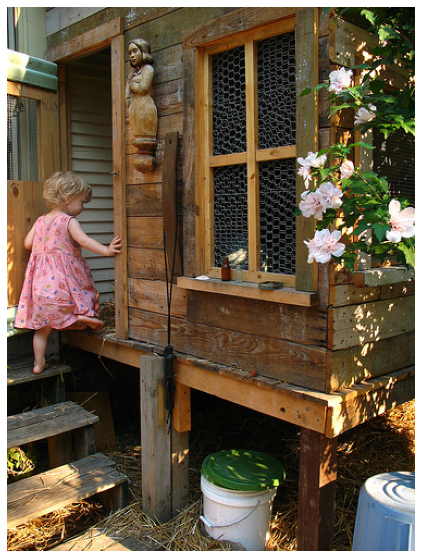

Dog running.


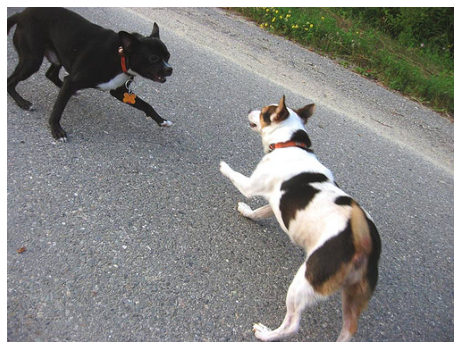

Two children are are are are are are are are are are are are are are are are are are are are are are are are are are are are are are.


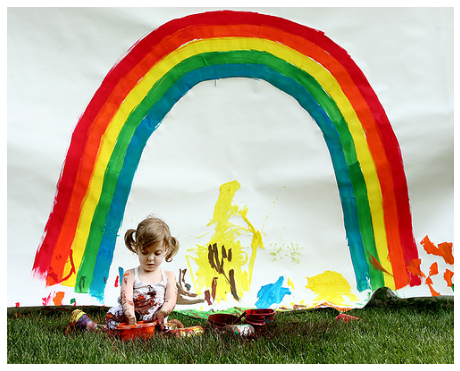

Dog is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is.


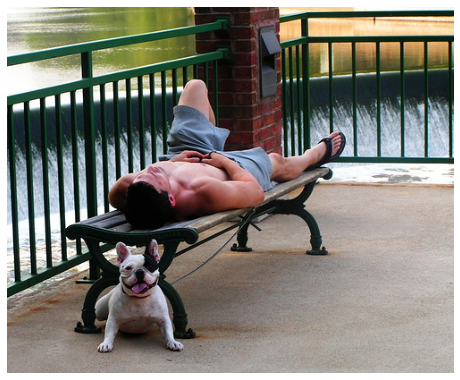

Man is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is.


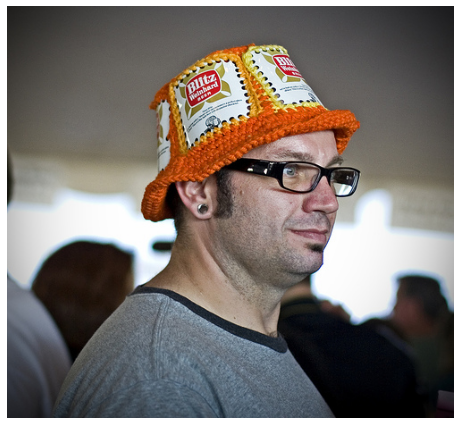

Boy is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is.


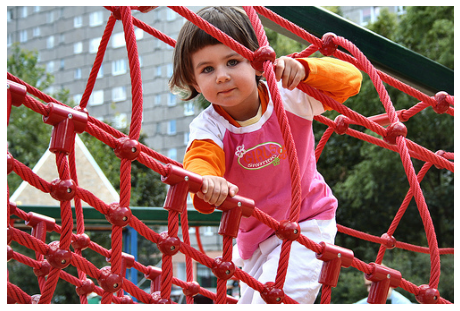

Dog running.


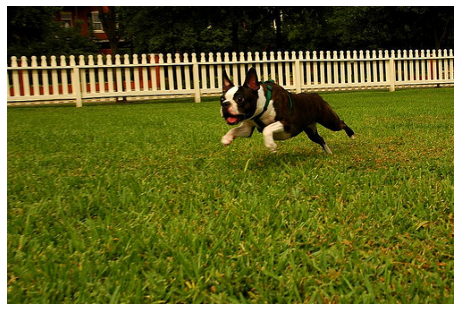

Dog is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is.


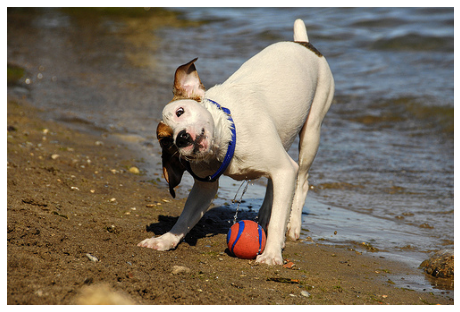

Man is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is is.


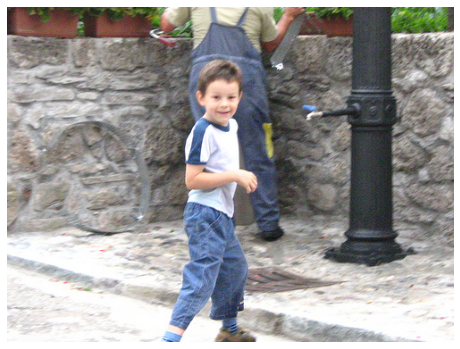

Dog running.


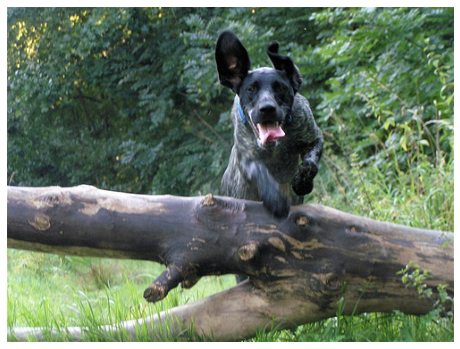

In [ ]:
checkpoint.restore('/Image Captioning/Model 1 Checkpoints/ckpt-5')

images_to_test = list(train_descriptions.keys())[:10]
image_dir = '/Image Captioning/Flicker8k_Dataset'

model = VGG16()
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)

for pic in images_to_test:
  ig = image_dir + '/' + pic + '.jpg'
  image = load_img(ig, target_size=(224,224))
  image = img_to_array(image)
  image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
  image = preprocess_input(image)
  features = model.predict(image,verbose=0)
  ig = mpimg.imread(ig)

  caption = generate_caption(features)
  caption = ' '.join(caption.split()[1:-1]).capitalize() + '.'
  print(caption)
  plt.figure(figsize=(8,10))
  plt.imshow(ig)
  plt.axis('off')
  plt.show()

Based on the above captions, it is obvious that this model has considerable shortcomings, primarily in the predicate of the sentence. It does a halfway decent job of capturing the actual subject of the image, but it is completely incapable of describing what the subject is doing.  

In [ ]:
evaluate_captions()

100%|██████████| 1000/1000 [06:54<00:00,  2.42it/s]


=================== Training ===================

BLEU-1: 0.050147
BLEU-2: 0.021118
BLEU-3: 0.003967
BLEU-4: 0.015160




100%|██████████| 1000/1000 [06:55<00:00,  2.41it/s]


=================== Testing ===================

BLEU-1: 0.044716
BLEU-2: 0.016964
BLEU-3: 0.003431
BLEU-4: 0.013579


The shortcomings evident in the above captions prove even more glaring when it comes to this model's BLEU scores. The model performs well on neither the training set nor the test set.

# **Model 2**

Encoder Embedding Dimension: 256

Encoder/Decoder Hidden Units: 512

Decoder RNN Layers: 2

Decoder Dense Layers: 1

Batch Size: 64


## Model Classes

In [ ]:
# text encoder portion of the image captioning system
class Encoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,enc_units,batch_sz):
    super(Encoder, self).__init__()
    self.batch_sz = batch_sz
    self.enc_units = enc_units
    self.embedding = tf.keras.layers.Embedding(vocab_size,embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    
  def call(self, x, hidden):
    x = self.embedding(x)
    output, state = self.GRU1(x, initial_state=hidden)
    output, state = self.GRU2(output)
    
    return output, state

  def initialize_hidden_state(self):
    return tf.zeros((self.batch_sz, self.enc_units))


# attention mechanism applied to the encoded text
class BahdanauAttention(tf.keras.layers.Layer):
  def __init__(self, units):
    super(BahdanauAttention, self).__init__()
    self.W1 = tf.keras.layers.Dense(units)
    self.W2 = tf.keras.layers.Dense(units)
    self.V = tf.keras.layers.Dense(1)

  def call(self, query, values):
    query_with_time_axis = tf.expand_dims(query, 1)
    score = self.V(tf.nn.tanh(
        self.W1(query_with_time_axis) + self.W2(values)
    ))

    attention_weights = tf.nn.softmax(score, axis=1)

    context_vector = attention_weights*values
    context_vector = tf.reduce_sum(context_vector, axis=1)

    return context_vector, attention_weights



# decoder portion of the system that combines encoded text and encoded images 
class Decoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,dec_units,batch_sz):
    super(Decoder, self).__init__()
    self.batch_sz = batch_sz
    self.dec_units = dec_units
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')

    self.fc = tf.keras.layers.Dense(vocab_size)
    self.attention = BahdanauAttention(self.dec_units)

  def call(self, x, y, hidden, enc_output):
    context_vector, attention_weights = self.attention(hidden, enc_output)
    
    context_vector = tf.expand_dims(context_vector, 1)
    
    x = self.embedding(x)
    y = tf.expand_dims(y, 1)

    z = tf.concat([context_vector, x, y], axis=-1)

    output, state = self.GRU1(z)
    output, state = self.GRU2(output)

    output = tf.reshape(output, (-1, output.shape[2]))

    x = self.fc(output)

    return x, state, attention_weights

## Setup

In [ ]:
# hyperparameter definition
buffer_size=len(input_tensor_train)
batch_size=64
steps_per_epoch=buffer_size//batch_size
embedding_dim=256
units=512
vocab_inp_size=len(inp_tokenizer.word_index)+1
vocab_targ_size=len(targ_tokenizer.word_index)+1

dataset = tf.data.Dataset.from_tensor_slices((input_tensor_train, X1, target_tensor_train)).shuffle(buffer_size)
dataset = dataset.batch(batch_size,drop_remainder=True)

# example pass through a single batch
example_lang_batch, example_photo_batch, example_target_batch = next(iter(dataset))
print(f'Input Text Shape: {example_lang_batch.shape}')
print(f'Input Photo Shape: {example_photo_batch.shape}')
print(f'Target Shape: {example_target_batch.shape}')

encoder = Encoder(vocab_inp_size, embedding_dim, units, batch_size)

sample_hidden = encoder.initialize_hidden_state()
sample_output, sample_hidden = encoder(example_lang_batch, sample_hidden)

print(f'Encoder output shape: {sample_output.shape}')
print(f'Encoder hidden state shape: {sample_hidden.shape}')

attention_layer = BahdanauAttention(10)
attention_result, attention_weights = attention_layer(sample_hidden, sample_output)

print(f'Attention result shape: {attention_result.shape}')
print(f'Attention weights shape: {attention_weights.shape}')

decoder = Decoder(vocab_targ_size, embedding_dim, units, batch_size)

sample_decoder_output, _, _ = decoder(tf.random.uniform((batch_size,1)), example_photo_batch, sample_hidden, sample_output)

print(f'Decoder output shape: {sample_decoder_output.shape}')

optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')

checkpoint_dir = '/Image Captioning/Model 2 Checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')
checkpoint = tf.train.Checkpoint(optimizer=optimizer, encoder=encoder, decoder=decoder)

Input Text Shape: (64, 33)
Input Photo Shape: (64, 4096)
Target Shape: (64, 1)
Encoder output shape: (64, 33, 512)
Encoder hidden state shape: (64, 512)
Attention result shape: (64, 512)
Attention weights shape: (64, 33, 1)
Decoder output shape: (64, 7578)


## Training

In [ ]:
epochs = 10

for epoch in range(epochs):
  start = time.time()

  enc_hidden = encoder.initialize_hidden_state()
  total_loss = 0

  for (batch, (lang_inp,photo_inp,targ)) in enumerate(dataset.take(steps_per_epoch)):
    batch_loss = image_train_step(lang_inp, photo_inp, targ, enc_hidden)
    total_loss += batch_loss

    if batch % 100 == 0:
      print(f'Epoch {epoch+1} Batch {batch} Loss {batch_loss.numpy()}')

  # checkpointing every other epoch starting with the second
  if (epoch+1) % 2 == 0:
    checkpoint.save(file_prefix=checkpoint_prefix)

  print(f'Epoch {epoch+1} Loss {total_loss/steps_per_epoch}')
  print(f'Time taken for 1 epoch: {time.time() - start} seconds\n')

Epoch 1 Batch 0 Loss 8.931087493896484
Epoch 1 Batch 100 Loss 6.202685832977295
Epoch 1 Batch 200 Loss 5.870700836181641
Epoch 1 Batch 300 Loss 5.710547924041748
Epoch 1 Batch 400 Loss 5.771618843078613
Epoch 1 Batch 500 Loss 5.586208343505859
Epoch 1 Batch 600 Loss 5.8079938888549805
Epoch 1 Batch 700 Loss 5.477144718170166
Epoch 1 Batch 800 Loss 5.322765827178955
Epoch 1 Batch 900 Loss 5.455778121948242
Epoch 1 Batch 1000 Loss 4.651614665985107
Epoch 1 Batch 1100 Loss 5.202216625213623
Epoch 1 Batch 1200 Loss 4.900790214538574
Epoch 1 Batch 1300 Loss 5.138513088226318
Epoch 1 Batch 1400 Loss 5.5193915367126465
Epoch 1 Batch 1500 Loss 5.599581718444824
Epoch 1 Batch 1600 Loss 4.983196258544922
Epoch 1 Batch 1700 Loss 6.070287704467773
Epoch 1 Batch 1800 Loss 5.028663635253906
Epoch 1 Batch 1900 Loss 5.486349105834961
Epoch 1 Batch 2000 Loss 4.928743839263916
Epoch 1 Batch 2100 Loss 4.946344375610352
Epoch 1 Batch 2200 Loss 5.049411296844482
Epoch 1 Batch 2300 Loss 5.230064868927002
Ep

## Testing

Man is sitting in the doorway.


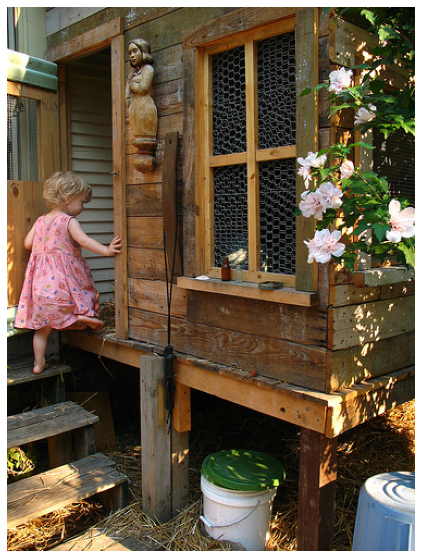

Two dogs are running in the snow.


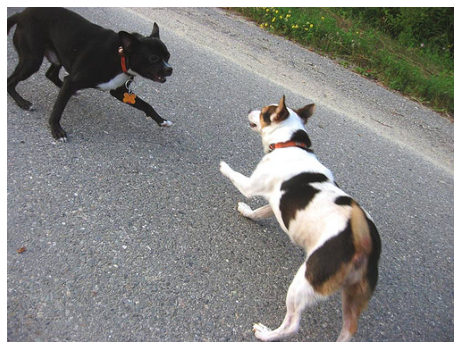

Little girl in red dress is in yellow dress in the grass.


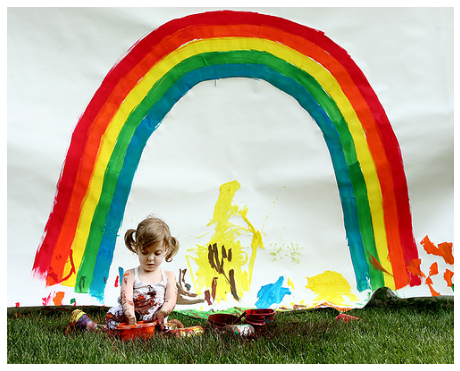

Man is petting white dog.


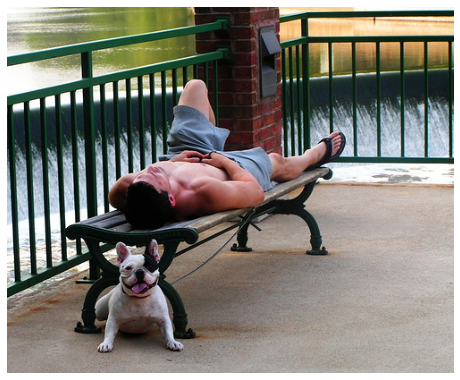

Man with red hat and red hat and red hat and red hat and red hat and red hat and red hat and red hat and red hat and red hat and.


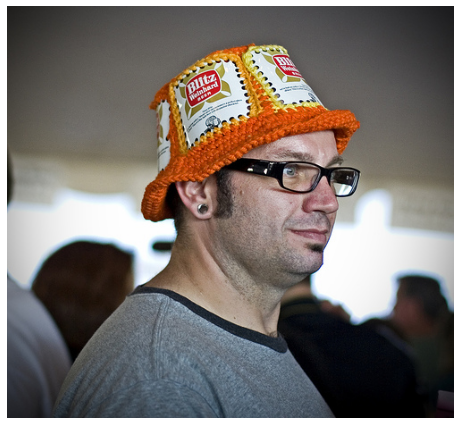

Child is climbing from red slide.


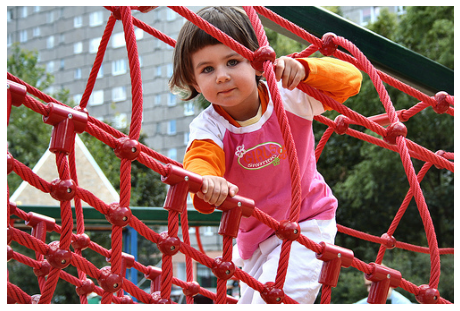

Black and white dog is jumping over the grass.


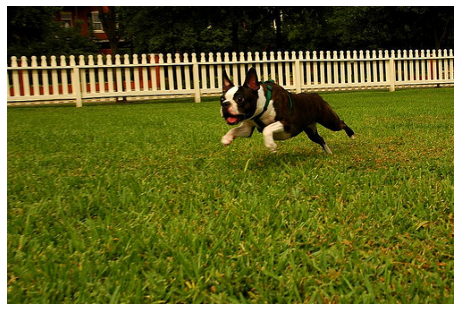

Brown dog is running in the water.


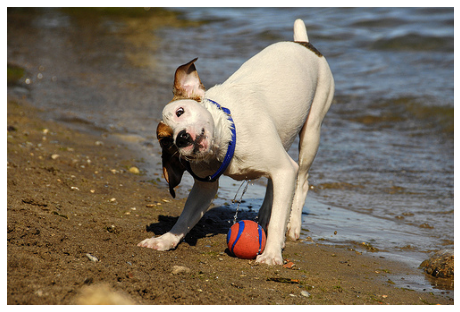

Young boy in black jacket is standing in the street.


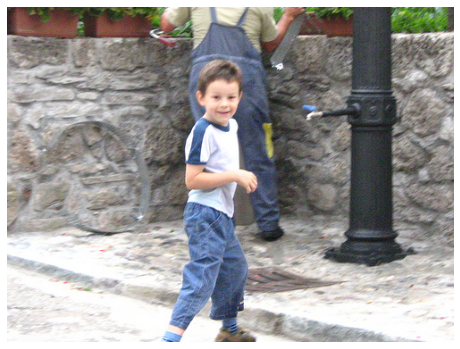

Black dog is running in the grass.


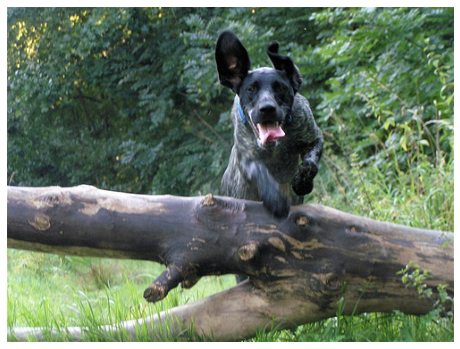

In [ ]:
checkpoint.restore('/Image Captioning/Model 2 Checkpoints/ckpt-5')

images_to_test = list(train_descriptions.keys())[:10]
image_dir = '/Image Captioning/Flicker8k_Dataset'

model = VGG16()
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)

for pic in images_to_test:
  ig = image_dir + '/' + pic + '.jpg'
  image = load_img(ig, target_size=(224,224))
  image = img_to_array(image)
  image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
  image = preprocess_input(image)
  features = model.predict(image,verbose=0)
  ig = mpimg.imread(ig)

  caption = generate_caption(features)
  caption = ' '.join(caption.split()[1:-1]).capitalize() + '.'
  print(caption)
  plt.figure(figsize=(8,10))
  plt.imshow(ig)
  plt.axis('off')
  plt.show()

These captions appear far superior than those from Model 1. The model here is capable of not only understanding what subjects are in the images, but it can also describe with some degree of goodness what these subjects actually are doing. Some of the captions are still incorrect - a few face serious repetition problems - but they are intelligble captions for the most part nonetheless.  

In [ ]:
evaluate_captions()

100%|██████████| 1000/1000 [03:10<00:00,  5.24it/s]


=================== Training ===================

BLEU-1: 0.533705
BLEU-2: 0.355855
BLEU-3: 0.228456


100%|██████████| 1000/1000 [03:09<00:00,  5.27it/s]


BLEU-4: 0.136373


=================== Testing ===================

BLEU-1: 0.467059
BLEU-2: 0.288804
BLEU-3: 0.174927
BLEU-4: 0.099566


These BLEU scores are far superior to those from the previous model. Eliminating the second dense layer in the decoder portion of the system appears to have paid huge dividends. Still, the model does appear to be overfitting the training data to some degree

# **Model 3**

Encoder Embedding Dimension: 256

Encoder/Decoder Hidden Units: 256

Decoder RNN Layers: 2

Decoder Dense Layers: 1

Batch Size: 64

## Model Classes

In [ ]:
# text encoder portion of the image captioning system
class Encoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,enc_units,batch_sz):
    super(Encoder, self).__init__()
    self.batch_sz = batch_sz
    self.enc_units = enc_units
    self.embedding = tf.keras.layers.Embedding(vocab_size,embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    
  def call(self, x, hidden):
    x = self.embedding(x)
    output, state = self.GRU1(x, initial_state=hidden)
    output, state = self.GRU2(output)
    
    return output, state

  def initialize_hidden_state(self):
    return tf.zeros((self.batch_sz, self.enc_units))


# attention mechanism applied to the encoded text
class BahdanauAttention(tf.keras.layers.Layer):
  def __init__(self, units):
    super(BahdanauAttention, self).__init__()
    self.W1 = tf.keras.layers.Dense(units)
    self.W2 = tf.keras.layers.Dense(units)
    self.V = tf.keras.layers.Dense(1)

  def call(self, query, values):
    query_with_time_axis = tf.expand_dims(query, 1)
    score = self.V(tf.nn.tanh(
        self.W1(query_with_time_axis) + self.W2(values)
    ))

    attention_weights = tf.nn.softmax(score, axis=1)

    context_vector = attention_weights*values
    context_vector = tf.reduce_sum(context_vector, axis=1)

    return context_vector, attention_weights


# decoder portion of the system that combines encoded text and encoded images 
class Decoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,dec_units,batch_sz):
    super(Decoder, self).__init__()
    self.batch_sz = batch_sz
    self.dec_units = dec_units
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')

    self.fc = tf.keras.layers.Dense(vocab_size)
    self.attention = BahdanauAttention(self.dec_units)

  def call(self, x, y, hidden, enc_output):
    context_vector, attention_weights = self.attention(hidden, enc_output)
    
    context_vector = tf.expand_dims(context_vector, 1)
    
    x = self.embedding(x)
    y = tf.expand_dims(y, 1)

    z = tf.concat([context_vector, x, y], axis=-1)

    output, state = self.GRU1(z)
    output, state = self.GRU2(output)

    output = tf.reshape(output, (-1, output.shape[2]))

    x = self.fc(output)

    return x, state, attention_weights

## Setup

In [ ]:
# hyperparameter definition
buffer_size=len(input_tensor_train)
batch_size=64
steps_per_epoch=buffer_size//batch_size
embedding_dim=256
units=256
vocab_inp_size=len(inp_tokenizer.word_index)+1
vocab_targ_size=len(targ_tokenizer.word_index)+1

dataset = tf.data.Dataset.from_tensor_slices((input_tensor_train, X1, target_tensor_train)).shuffle(buffer_size)
dataset = dataset.batch(batch_size,drop_remainder=True)

# example pass through a single batch
example_lang_batch, example_photo_batch, example_target_batch = next(iter(dataset))
print(f'Input Text Shape: {example_lang_batch.shape}')
print(f'Input Photo Shape: {example_photo_batch.shape}')
print(f'Target Shape: {example_target_batch.shape}')

encoder = Encoder(vocab_inp_size, embedding_dim, units, batch_size)

sample_hidden = encoder.initialize_hidden_state()
sample_output, sample_hidden = encoder(example_lang_batch, sample_hidden)

print(f'Encoder output shape: {sample_output.shape}')
print(f'Encoder hidden state shape: {sample_hidden.shape}')

attention_layer = BahdanauAttention(10)
attention_result, attention_weights = attention_layer(sample_hidden, sample_output)

print(f'Attention result shape: {attention_result.shape}')
print(f'Attention weights shape: {attention_weights.shape}')

decoder = Decoder(vocab_targ_size, embedding_dim, units, batch_size)

sample_decoder_output, _, _ = decoder(tf.random.uniform((batch_size,1)), example_photo_batch, sample_hidden, sample_output)

print(f'Decoder output shape: {sample_decoder_output.shape}')

optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')

checkpoint_dir = '/Image Captioning/Model 3 Checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')
checkpoint = tf.train.Checkpoint(optimizer=optimizer, encoder=encoder, decoder=decoder)

Input Text Shape: (64, 33)
Input Photo Shape: (64, 4096)
Target Shape: (64, 1)
Encoder output shape: (64, 33, 256)
Encoder hidden state shape: (64, 256)
Attention result shape: (64, 256)
Attention weights shape: (64, 33, 1)
Decoder output shape: (64, 7578)


## Training

In [ ]:
epochs = 10

for epoch in range(epochs):
  start = time.time()

  enc_hidden = encoder.initialize_hidden_state()
  total_loss = 0

  for (batch, (lang_inp,photo_inp,targ)) in enumerate(dataset.take(steps_per_epoch)):
    batch_loss = image_train_step(lang_inp, photo_inp, targ, enc_hidden)
    total_loss += batch_loss

    if batch % 100 == 0:
      print(f'Epoch {epoch+1} Batch {batch} Loss {batch_loss.numpy()}')

  # checkpointing every other epoch starting with the second
  if (epoch+1) % 2 == 0:
    checkpoint.save(file_prefix=checkpoint_prefix)

  print(f'Epoch {epoch+1} Loss {total_loss/steps_per_epoch}')
  print(f'Time taken for 1 epoch: {time.time() - start} seconds\n')

Epoch 1 Batch 0 Loss 8.929384231567383
Epoch 1 Batch 100 Loss 6.145560264587402
Epoch 1 Batch 200 Loss 6.174557209014893
Epoch 1 Batch 300 Loss 5.913923263549805
Epoch 1 Batch 400 Loss 5.318254470825195
Epoch 1 Batch 500 Loss 5.65564489364624
Epoch 1 Batch 600 Loss 5.848764419555664
Epoch 1 Batch 700 Loss 5.426248550415039
Epoch 1 Batch 800 Loss 5.801058769226074
Epoch 1 Batch 900 Loss 5.868327617645264
Epoch 1 Batch 1000 Loss 6.297114372253418
Epoch 1 Batch 1100 Loss 5.4207868576049805
Epoch 1 Batch 1200 Loss 5.553759574890137
Epoch 1 Batch 1300 Loss 4.7562713623046875
Epoch 1 Batch 1400 Loss 5.479341983795166
Epoch 1 Batch 1500 Loss 4.994499683380127
Epoch 1 Batch 1600 Loss 5.6080002784729
Epoch 1 Batch 1700 Loss 5.771770477294922
Epoch 1 Batch 1800 Loss 5.724920272827148
Epoch 1 Batch 1900 Loss 5.796903610229492
Epoch 1 Batch 2000 Loss 4.940573215484619
Epoch 1 Batch 2100 Loss 5.989038467407227
Epoch 1 Batch 2200 Loss 5.3804216384887695
Epoch 1 Batch 2300 Loss 5.324878692626953
Epoc

## Testing

Young girl is sitting on wooden bench.


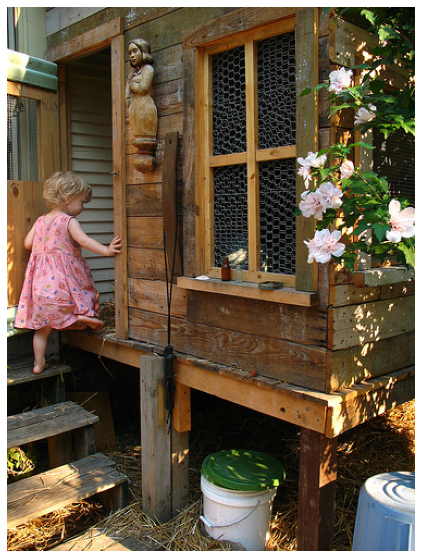

Two dogs are fighting on the beach.


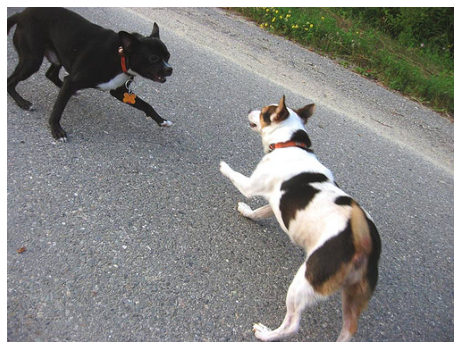

Two children are standing in the field.


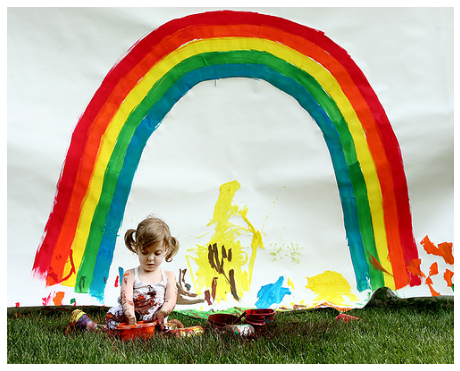

Man is walking on bench.


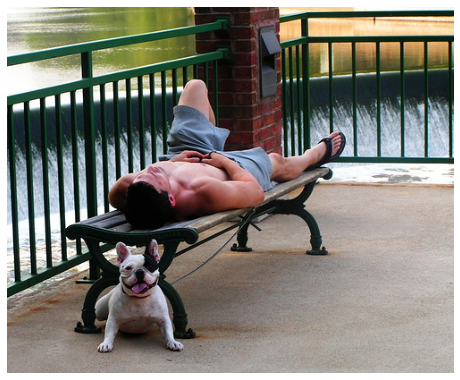

Man with glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and.


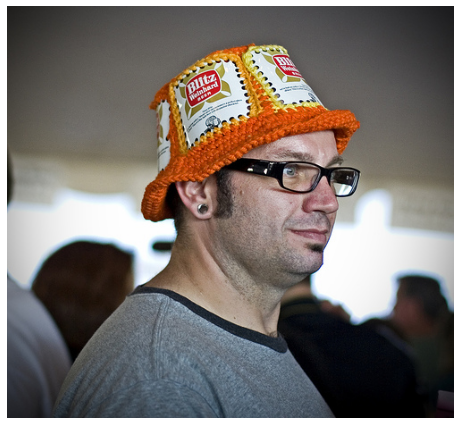

Child in red jacket is hanging on the playground.


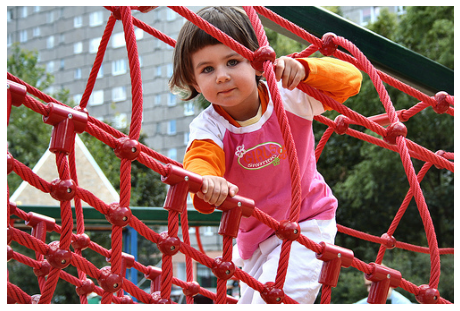

Black dog is jumping over the grass.


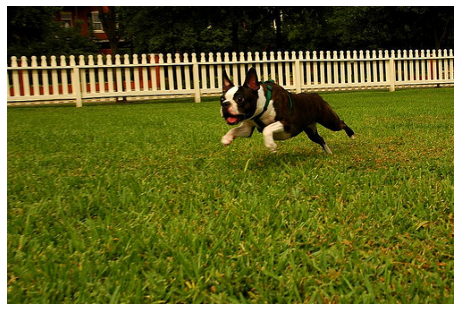

Dog runs on the beach.


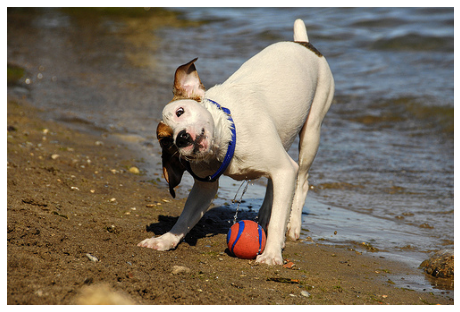

Young boy in red shirt and red shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt.


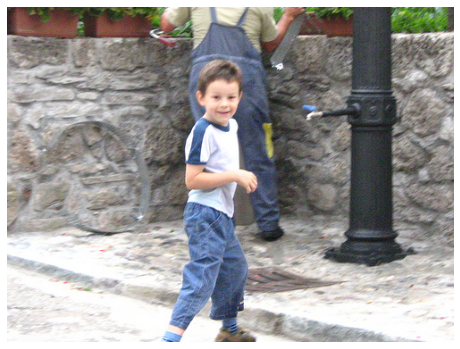

Black dog is running through the grass.


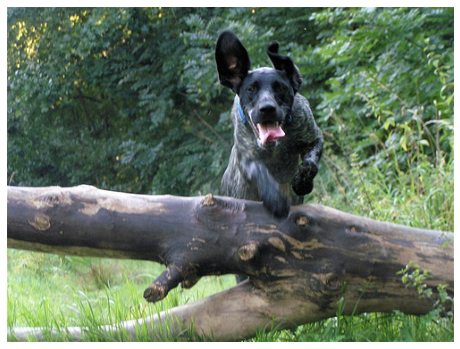

In [ ]:
checkpoint.restore('/Image Captioning/Model 3 Checkpoints/ckpt-5')

images_to_test = list(train_descriptions.keys())[:10]
image_dir = '/Image Captioning/Flicker8k_Dataset'

model = VGG16()
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)

for pic in images_to_test:
  ig = image_dir + '/' + pic + '.jpg'
  image = load_img(ig, target_size=(224,224))
  image = img_to_array(image)
  image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
  image = preprocess_input(image)
  features = model.predict(image,verbose=0)
  ig = mpimg.imread(ig)

  caption = generate_caption(features)
  caption = ' '.join(caption.split()[1:-1]).capitalize() + '.'
  print(caption)
  plt.figure(figsize=(8,10))
  plt.imshow(ig)
  plt.axis('off')
  plt.show()

Compared to the previous two models, this model seems to do the best job of understanding what the objects in the image are. It is the first to caption the subject of the first image as " young girl" instead of "man", and it also captures the fact that the sixth picture includes a "playground" and not a "slide". However, there is still a bit of a repetition problem, and the verbs of the sentences are not perfect either.

In [ ]:
evaluate_captions()

100%|██████████| 1000/1000 [12:22<00:00,  1.35it/s]


=================== Training ===================

BLEU-1: 0.514368
BLEU-2: 0.344701
BLEU-3: 0.219459
BLEU-4: 0.128173




100%|██████████| 1000/1000 [12:13<00:00,  1.36it/s]


=================== Testing ===================

BLEU-1: 0.409705
BLEU-2: 0.245276
BLEU-3: 0.144927
BLEU-4: 0.079036


Despite what seem to be slightly better captions in the sample of images above, the BLEU scores here are slower than those belonging to Model 2. The reduction of the number of hidden units in the encoder and decoder portions of the system has reduced the model's capacity, and by extension, the BLEU scores that it produces.

# **Model 4**

Encoder Embedding Dimension: 256

Encoder/Decoder Hidden Units: 512

Decoder RNN Layers: 2

Decoder Dense Layers: 1

Batch Size: 32

## Model Classes

In [ ]:
# text encoder portion of the image captioning system
class Encoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,enc_units,batch_sz):
    super(Encoder, self).__init__()
    self.batch_sz = batch_sz
    self.enc_units = enc_units
    self.embedding = tf.keras.layers.Embedding(vocab_size,embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    
  def call(self, x, hidden):
    x = self.embedding(x)
    output, state = self.GRU1(x, initial_state=hidden)
    output, state = self.GRU2(output)
    
    return output, state

  def initialize_hidden_state(self):
    return tf.zeros((self.batch_sz, self.enc_units))


# attention mechanism applied to the encoded text
class BahdanauAttention(tf.keras.layers.Layer):
  def __init__(self, units):
    super(BahdanauAttention, self).__init__()
    self.W1 = tf.keras.layers.Dense(units)
    self.W2 = tf.keras.layers.Dense(units)
    self.V = tf.keras.layers.Dense(1)

  def call(self, query, values):
    query_with_time_axis = tf.expand_dims(query, 1)
    score = self.V(tf.nn.tanh(
        self.W1(query_with_time_axis) + self.W2(values)
    ))

    attention_weights = tf.nn.softmax(score, axis=1)

    context_vector = attention_weights*values
    context_vector = tf.reduce_sum(context_vector, axis=1)

    return context_vector, attention_weights


# decoder portion of the system that combines encoded text and encoded images 
class Decoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,dec_units,batch_sz):
    super(Decoder, self).__init__()
    self.batch_sz = batch_sz
    self.dec_units = dec_units
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')

    self.fc = tf.keras.layers.Dense(vocab_size)
    self.attention = BahdanauAttention(self.dec_units)

  def call(self, x, y, hidden, enc_output):
    context_vector, attention_weights = self.attention(hidden, enc_output)
    
    context_vector = tf.expand_dims(context_vector, 1)
    
    x = self.embedding(x)
    y = tf.expand_dims(y, 1)

    z = tf.concat([context_vector, x, y], axis=-1)

    output, state = self.GRU1(z)
    output, state = self.GRU2(output)

    output = tf.reshape(output, (-1, output.shape[2]))

    x = self.fc(output)

    return x, state, attention_weights

## Setup

In [ ]:
# hyperparameter definition
buffer_size=len(input_tensor_train)
batch_size=32
steps_per_epoch=buffer_size//batch_size
embedding_dim=256
units=512
vocab_inp_size=len(inp_tokenizer.word_index)+1
vocab_targ_size=len(targ_tokenizer.word_index)+1

dataset = tf.data.Dataset.from_tensor_slices((input_tensor_train, X1, target_tensor_train)).shuffle(buffer_size)
dataset = dataset.batch(batch_size,drop_remainder=True)

# example pass through a single batch
example_lang_batch, example_photo_batch, example_target_batch = next(iter(dataset))
print(f'Input Text Shape: {example_lang_batch.shape}')
print(f'Input Photo Shape: {example_photo_batch.shape}')
print(f'Target Shape: {example_target_batch.shape}')

encoder = Encoder(vocab_inp_size, embedding_dim, units, batch_size)

sample_hidden = encoder.initialize_hidden_state()
sample_output, sample_hidden = encoder(example_lang_batch, sample_hidden)

print(f'Encoder output shape: {sample_output.shape}')
print(f'Encoder hidden state shape: {sample_hidden.shape}')

attention_layer = BahdanauAttention(10)
attention_result, attention_weights = attention_layer(sample_hidden, sample_output)

print(f'Attention result shape: {attention_result.shape}')
print(f'Attention weights shape: {attention_weights.shape}')

decoder = Decoder(vocab_targ_size, embedding_dim, units, batch_size)

sample_decoder_output, _, _ = decoder(tf.random.uniform((batch_size,1)), example_photo_batch, sample_hidden, sample_output)

print(f'Decoder output shape: {sample_decoder_output.shape}')

optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')

checkpoint_dir = '/Image Captioning/Model 4 Checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')
checkpoint = tf.train.Checkpoint(optimizer=optimizer, encoder=encoder, decoder=decoder)

Input Text Shape: (32, 33)
Input Photo Shape: (32, 4096)
Target Shape: (32, 1)
Encoder output shape: (32, 33, 512)
Encoder hidden state shape: (32, 512)
Attention result shape: (32, 512)
Attention weights shape: (32, 33, 1)
Decoder output shape: (32, 7578)


## Training

In [ ]:
epochs = 10

for epoch in range(epochs):
  start = time.time()

  enc_hidden = encoder.initialize_hidden_state()
  total_loss = 0

  for (batch, (lang_inp,photo_inp,targ)) in enumerate(dataset.take(steps_per_epoch)):
    batch_loss = image_train_step(lang_inp, photo_inp, targ, enc_hidden)
    total_loss += batch_loss

    if batch % 100 == 0:
      print(f'Epoch {epoch+1} Batch {batch} Loss {batch_loss.numpy()}')

  # checkpointing every other epoch starting with the second
  if (epoch+1) % 2 == 0:
    checkpoint.save(file_prefix=checkpoint_prefix)

  print(f'Epoch {epoch+1} Loss {total_loss/steps_per_epoch}')
  print(f'Time taken for 1 epoch: {time.time() - start} seconds\n')

Epoch 1 Batch 0 Loss 8.93307876586914
Epoch 1 Batch 100 Loss 7.045398235321045
Epoch 1 Batch 200 Loss 6.17872428894043
Epoch 1 Batch 300 Loss 6.358160018920898
Epoch 1 Batch 400 Loss 6.1493072509765625
Epoch 1 Batch 500 Loss 5.540727615356445
Epoch 1 Batch 600 Loss 6.142734527587891
Epoch 1 Batch 700 Loss 5.486658096313477
Epoch 1 Batch 800 Loss 5.965748310089111
Epoch 1 Batch 900 Loss 5.932860851287842
Epoch 1 Batch 1000 Loss 5.50593376159668
Epoch 1 Batch 1100 Loss 5.81208610534668
Epoch 1 Batch 1200 Loss 5.470888137817383
Epoch 1 Batch 1300 Loss 6.2922444343566895
Epoch 1 Batch 1400 Loss 6.357024669647217
Epoch 1 Batch 1500 Loss 6.00166130065918
Epoch 1 Batch 1600 Loss 4.933104991912842
Epoch 1 Batch 1700 Loss 5.677193641662598
Epoch 1 Batch 1800 Loss 4.876231670379639
Epoch 1 Batch 1900 Loss 6.612786293029785
Epoch 1 Batch 2000 Loss 5.728168487548828
Epoch 1 Batch 2100 Loss 5.790733814239502
Epoch 1 Batch 2200 Loss 5.497822284698486
Epoch 1 Batch 2300 Loss 6.183346271514893
Epoch 1

## Testing

.


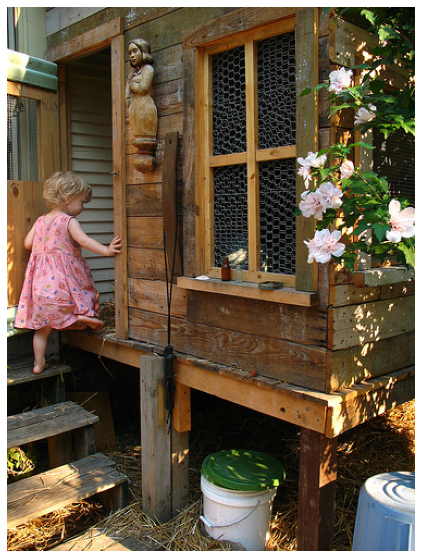

.


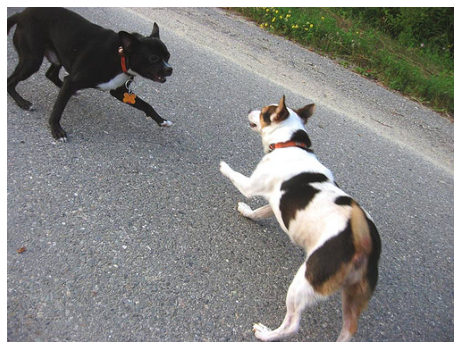

.


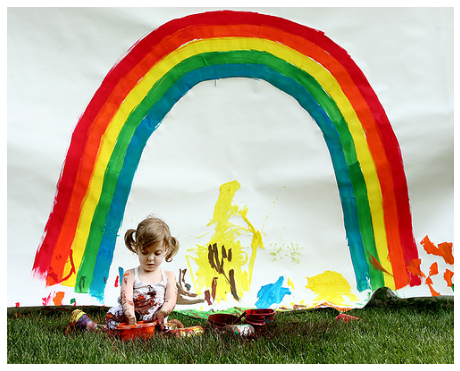

.


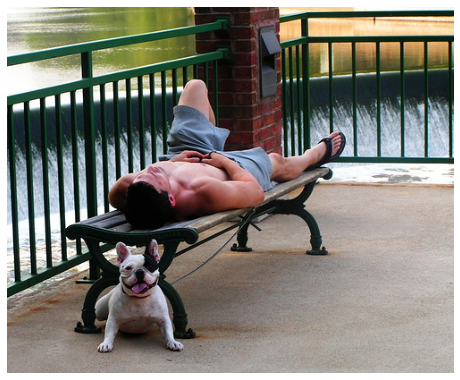

.


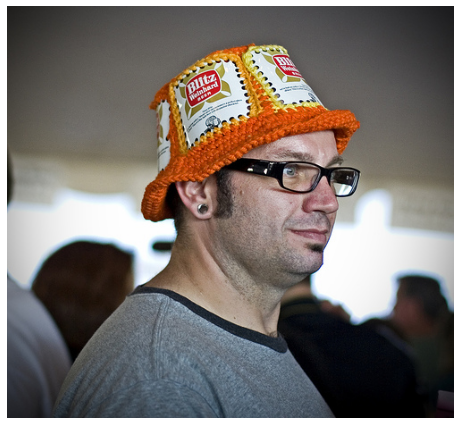

.


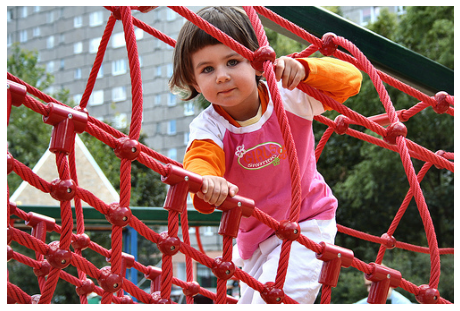

.


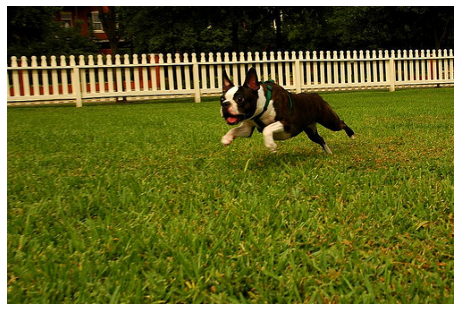

Dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog.


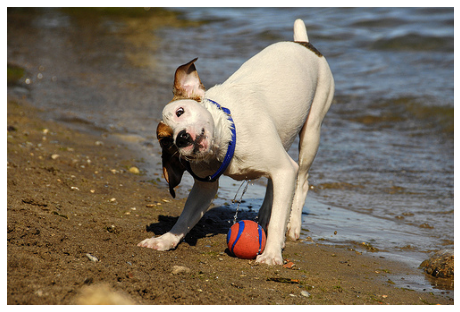

.


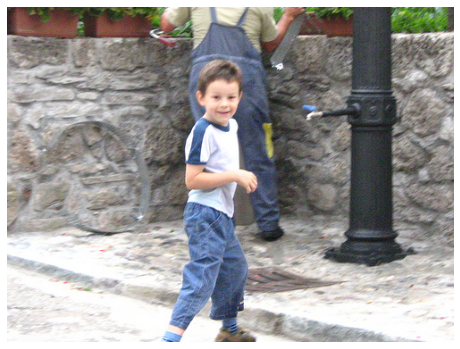

Dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog.


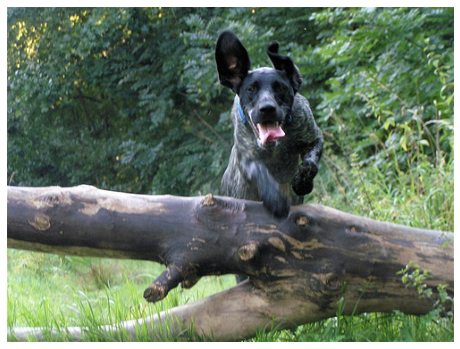

In [ ]:
checkpoint.restore('/Image Captioning/Model 4 Checkpoints/ckpt-5')

images_to_test = list(train_descriptions.keys())[:10]
image_dir = '/Image Captioning/Flicker8k_Dataset'

model = VGG16()
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)

for pic in images_to_test:
  ig = image_dir + '/' + pic + '.jpg'
  image = load_img(ig, target_size=(224,224))
  image = img_to_array(image)
  image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
  image = preprocess_input(image)
  features = model.predict(image,verbose=0)
  ig = mpimg.imread(ig)

  caption = generate_caption(features)
  caption = ' '.join(caption.split()[1:-1]).capitalize() + '.'
  print(caption)
  plt.figure(figsize=(8,10))
  plt.imshow(ig)
  plt.axis('off')
  plt.show()

In [ ]:
evaluate_captions()

100%|██████████| 1000/1000 [02:42<00:00,  6.17it/s]


=================== Training ===================

BLEU-1: 0.033215
BLEU-2: 0.179981
BLEU-3: 0.319705
BLEU-4: 0.418960




100%|██████████| 1000/1000 [02:02<00:00,  8.16it/s]


=================== Testing ===================

BLEU-1: 0.018179
BLEU-2: 0.104000
BLEU-3: 0.188180
BLEU-4: 0.248753


This model can probably best be summed up as a tremendous swing and miss. Returning the number of hidden units in the encoder and decoder portions of the system to 512 while also reducing the batch size to 32 has severely decreased the model's predictive power. The batch size of 64 might therefore be thought of as a sort of lower bound for batch size when working with this particular architecture

# **Model 5**

Encoder Embedding Dimension: 256

Encoder/Decoder Hidden Units: 512

Decoder RNN Layers: 2

Decoder Dense Layers: 1

Batch Size: 128

## Model Classes

In [ ]:
# text encoder portion of the image captioning system
class Encoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,enc_units,batch_sz):
    super(Encoder, self).__init__()
    self.batch_sz = batch_sz
    self.enc_units = enc_units
    self.embedding = tf.keras.layers.Embedding(vocab_size,embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    
  def call(self, x, hidden):
    x = self.embedding(x)
    output, state = self.GRU1(x, initial_state=hidden)
    output, state = self.GRU2(output)
    
    return output, state

  def initialize_hidden_state(self):
    return tf.zeros((self.batch_sz, self.enc_units))


# attention mechanism applied to the encoded text
class BahdanauAttention(tf.keras.layers.Layer):
  def __init__(self, units):
    super(BahdanauAttention, self).__init__()
    self.W1 = tf.keras.layers.Dense(units)
    self.W2 = tf.keras.layers.Dense(units)
    self.V = tf.keras.layers.Dense(1)

  def call(self, query, values):
    query_with_time_axis = tf.expand_dims(query, 1)
    score = self.V(tf.nn.tanh(
        self.W1(query_with_time_axis) + self.W2(values)
    ))

    attention_weights = tf.nn.softmax(score, axis=1)

    context_vector = attention_weights*values
    context_vector = tf.reduce_sum(context_vector, axis=1)

    return context_vector, attention_weights


# decoder portion of the system that combines encoded text and encoded images 
class Decoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,dec_units,batch_sz):
    super(Decoder, self).__init__()
    self.batch_sz = batch_sz
    self.dec_units = dec_units
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')

    self.fc = tf.keras.layers.Dense(vocab_size)
    self.attention = BahdanauAttention(self.dec_units)

  def call(self, x, y, hidden, enc_output):
    context_vector, attention_weights = self.attention(hidden, enc_output)
    
    context_vector = tf.expand_dims(context_vector, 1)
    
    x = self.embedding(x)
    y = tf.expand_dims(y, 1)

    z = tf.concat([context_vector, x, y], axis=-1)

    output, state = self.GRU1(z)
    output, state = self.GRU2(output)

    output = tf.reshape(output, (-1, output.shape[2]))

    x = self.fc(output)

    return x, state, attention_weights

## Setup

In [ ]:
# hyperparameter definition
buffer_size=len(input_tensor_train)
batch_size=128
steps_per_epoch=buffer_size//batch_size
embedding_dim=256
units=512
vocab_inp_size=len(inp_tokenizer.word_index)+1
vocab_targ_size=len(targ_tokenizer.word_index)+1

dataset = tf.data.Dataset.from_tensor_slices((input_tensor_train, X1, target_tensor_train)).shuffle(buffer_size)
dataset = dataset.batch(batch_size,drop_remainder=True)

# example pass through a single batch
example_lang_batch, example_photo_batch, example_target_batch = next(iter(dataset))
print(f'Input Text Shape: {example_lang_batch.shape}')
print(f'Input Photo Shape: {example_photo_batch.shape}')
print(f'Target Shape: {example_target_batch.shape}')

encoder = Encoder(vocab_inp_size, embedding_dim, units, batch_size)

sample_hidden = encoder.initialize_hidden_state()
sample_output, sample_hidden = encoder(example_lang_batch, sample_hidden)

print(f'Encoder output shape: {sample_output.shape}')
print(f'Encoder hidden state shape: {sample_hidden.shape}')

attention_layer = BahdanauAttention(10)
attention_result, attention_weights = attention_layer(sample_hidden, sample_output)

print(f'Attention result shape: {attention_result.shape}')
print(f'Attention weights shape: {attention_weights.shape}')

decoder = Decoder(vocab_targ_size, embedding_dim, units, batch_size)

sample_decoder_output, _, _ = decoder(tf.random.uniform((batch_size,1)), example_photo_batch, sample_hidden, sample_output)

print(f'Decoder output shape: {sample_decoder_output.shape}')

optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')

checkpoint_dir = '/Image Captioning/Model 5 Checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')
checkpoint = tf.train.Checkpoint(optimizer=optimizer, encoder=encoder, decoder=decoder)

Input Text Shape: (128, 33)
Input Photo Shape: (128, 4096)
Target Shape: (128, 1)
Encoder output shape: (128, 33, 512)
Encoder hidden state shape: (128, 512)
Attention result shape: (128, 512)
Attention weights shape: (128, 33, 1)
Decoder output shape: (128, 7578)


## Training

In [ ]:
epochs = 10

for epoch in range(epochs):
  start = time.time()

  enc_hidden = encoder.initialize_hidden_state()
  total_loss = 0

  for (batch, (lang_inp,photo_inp,targ)) in enumerate(dataset.take(steps_per_epoch)):
    batch_loss = image_train_step(lang_inp, photo_inp, targ, enc_hidden)
    total_loss += batch_loss

    if batch % 100 == 0:
      print(f'Epoch {epoch+1} Batch {batch} Loss {batch_loss.numpy()}')

  # checkpointing every other epoch starting with the second
  if (epoch+1) % 2 == 0:
    checkpoint.save(file_prefix=checkpoint_prefix)

  print(f'Epoch {epoch+1} Loss {total_loss/steps_per_epoch}')
  print(f'Time taken for 1 epoch: {time.time() - start} seconds\n')

Epoch 1 Batch 0 Loss 8.93392562866211
Epoch 1 Batch 100 Loss 5.85007381439209
Epoch 1 Batch 200 Loss 5.797962665557861
Epoch 1 Batch 300 Loss 5.609662055969238
Epoch 1 Batch 400 Loss 5.587010860443115
Epoch 1 Batch 500 Loss 5.770895957946777
Epoch 1 Batch 600 Loss 5.422478675842285
Epoch 1 Batch 700 Loss 5.361174583435059
Epoch 1 Batch 800 Loss 5.596254825592041
Epoch 1 Batch 900 Loss 5.040440559387207
Epoch 1 Batch 1000 Loss 5.575319290161133
Epoch 1 Batch 1100 Loss 5.04416561126709
Epoch 1 Batch 1200 Loss 5.347106456756592
Epoch 1 Batch 1300 Loss 5.383054733276367
Epoch 1 Batch 1400 Loss 5.143579959869385
Epoch 1 Batch 1500 Loss 5.174595832824707
Epoch 1 Batch 1600 Loss 5.078394412994385
Epoch 1 Batch 1700 Loss 5.198034286499023
Epoch 1 Batch 1800 Loss 4.688577651977539
Epoch 1 Batch 1900 Loss 4.737057685852051
Epoch 1 Batch 2000 Loss 4.573928356170654
Epoch 1 Batch 2100 Loss 4.944484710693359
Epoch 1 Batch 2200 Loss 4.901263236999512
Epoch 1 Batch 2300 Loss 4.670071125030518
Epoch 1

## Testing

Two children sit in the area.


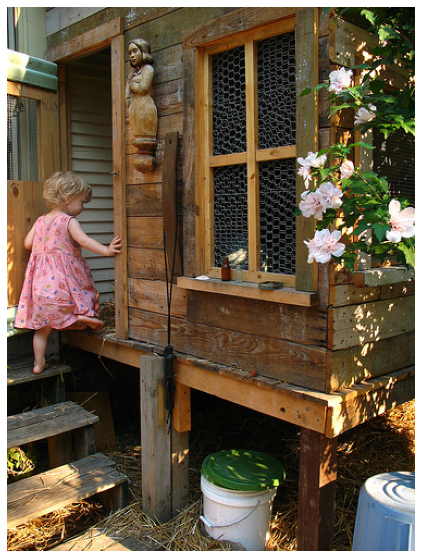

Two dogs are playing together in the sand.


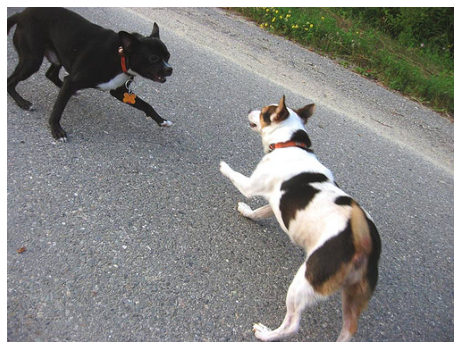

Little girl in red dress is sitting on the grass.


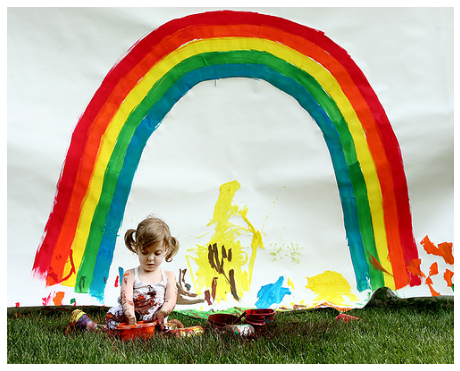

Man is sitting on bench.


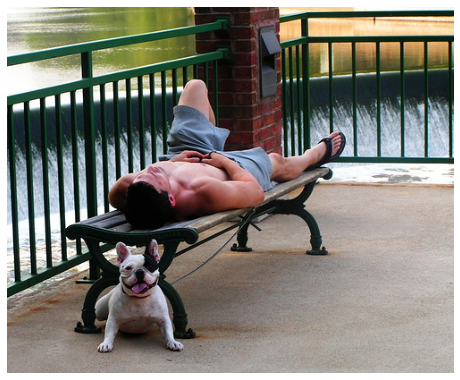

Man in black shirt is wearing sunglasses.


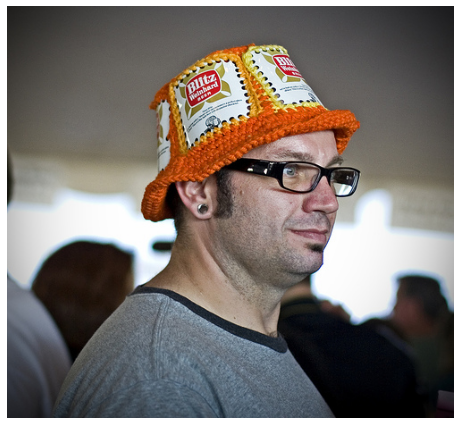

Child is climbing rope swing.


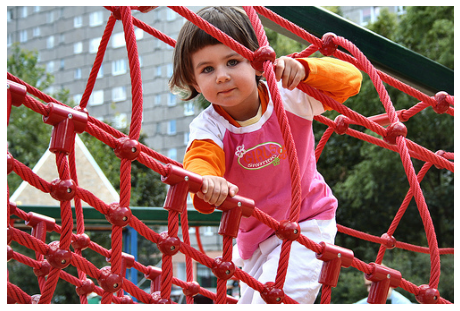

Dog jumping in the grass.


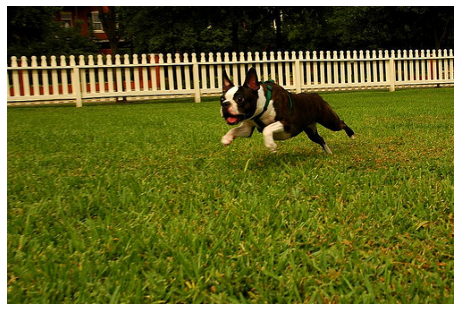

White dog with white collar is playing in the water.


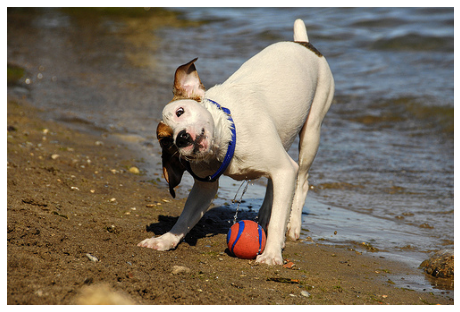

Young boy in black shirt is walking on the street.


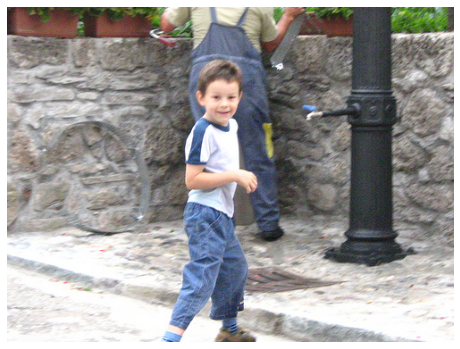

Black dog is jumping over log.


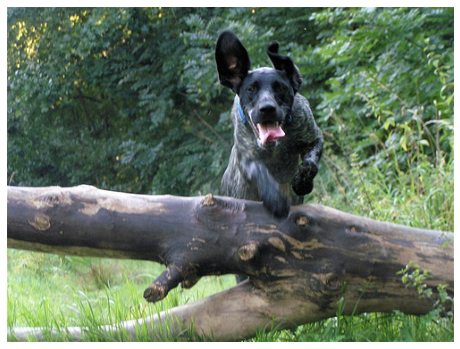

In [ ]:
checkpoint.restore('/Image Captioning/Model 5 Checkpoints/ckpt-5')

images_to_test = list(train_descriptions.keys())[:10]
image_dir = '/Image Captioning/Flicker8k_Dataset'

model = VGG16()
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)

for pic in images_to_test:
  ig = image_dir + '/' + pic + '.jpg'
  image = load_img(ig, target_size=(224,224))
  image = img_to_array(image)
  image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
  image = preprocess_input(image)
  features = model.predict(image,verbose=0)
  ig = mpimg.imread(ig)

  caption = generate_caption(features)
  caption = ' '.join(caption.split()[1:-1]).capitalize() + '.'
  print(caption)
  plt.figure(figsize=(8,10))
  plt.imshow(ig)
  plt.axis('off')
  plt.show()

This model appears to be the most consistent thus far. In general, it does a fairly good job of identifying both the objects in the image, as well as what those objects are doing. Where it appears to fall a bit short is in the images' details. The fifth picture's caption says that the man in the image is wearing a black shirt and sunglasses, while in reality only the collar of his shirt is black and his sunglasses are instead regular glasses. Something similar happens with the ninth image - it suggests that the young boy is wearing a black shirt, which is likely a result of the black telephone pole just beyond the boy. 

In [ ]:
evaluate_captions()

100%|██████████| 1000/1000 [03:00<00:00,  5.55it/s]


=================== Training ===================

BLEU-1: 0.571581
BLEU-2: 0.388233
BLEU-3: 0.250367
BLEU-4: 0.149163




100%|██████████| 1000/1000 [03:02<00:00,  5.48it/s]


=================== Testing ===================

BLEU-1: 0.464943
BLEU-2: 0.285186
BLEU-3: 0.167578
BLEU-4: 0.089663


This model's BLEU scores demonstrate improvement on only the training set and not the test set, when compared to the previous bests set by Model 2. While the average across the four training set BLEU scores has improved by about 8% from 0.3136 to 0.3398, the average of the four test set scores has dipped by about 2%, going from 0.2576 to 0.2518. Interestingly enough, the increased batch size seems to have added to the model's capacity and contributed to the model's overfitting.

# **Model 6**

Encoder Embedding Dimension: 256

Encoder/Decoder Hidden Units: 512

Decoder RNN Layers: 2

Decoder Dense Layers: 1

Batch Size: 256

## Model Classes

In [ ]:
# text encoder portion of the image captioning system
class Encoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,enc_units,batch_sz):
    super(Encoder, self).__init__()
    self.batch_sz = batch_sz
    self.enc_units = enc_units
    self.embedding = tf.keras.layers.Embedding(vocab_size,embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.enc_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    
  def call(self, x, hidden):
    x = self.embedding(x)
    output, state = self.GRU1(x, initial_state=hidden)
    output, state = self.GRU2(output)
    
    return output, state

  def initialize_hidden_state(self):
    return tf.zeros((self.batch_sz, self.enc_units))


# attention mechanism applied to the encoded text
class BahdanauAttention(tf.keras.layers.Layer):
  def __init__(self, units):
    super(BahdanauAttention, self).__init__()
    self.W1 = tf.keras.layers.Dense(units)
    self.W2 = tf.keras.layers.Dense(units)
    self.V = tf.keras.layers.Dense(1)

  def call(self, query, values):
    query_with_time_axis = tf.expand_dims(query, 1)
    score = self.V(tf.nn.tanh(
        self.W1(query_with_time_axis) + self.W2(values)
    ))

    attention_weights = tf.nn.softmax(score, axis=1)

    context_vector = attention_weights*values
    context_vector = tf.reduce_sum(context_vector, axis=1)

    return context_vector, attention_weights


# decoder portion of the system that combines encoded text and encoded images 
class Decoder(tf.keras.Model):
  def __init__(self,vocab_size,embedding_dim,dec_units,batch_sz):
    super(Decoder, self).__init__()
    self.batch_sz = batch_sz
    self.dec_units = dec_units
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.GRU1 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.GRU2 = tf.keras.layers.GRU(self.dec_units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')

    self.fc = tf.keras.layers.Dense(vocab_size)
    self.attention = BahdanauAttention(self.dec_units)

  def call(self, x, y, hidden, enc_output):
    context_vector, attention_weights = self.attention(hidden, enc_output)
    
    context_vector = tf.expand_dims(context_vector, 1)
    
    x = self.embedding(x)
    y = tf.expand_dims(y, 1)

    z = tf.concat([context_vector, x, y], axis=-1)

    output, state = self.GRU1(z)
    output, state = self.GRU2(output)

    output = tf.reshape(output, (-1, output.shape[2]))

    x = self.fc(output)

    return x, state, attention_weights

## Setup

In [ ]:
# hyperparameter definition
buffer_size=len(input_tensor_train)
batch_size=256
steps_per_epoch=buffer_size//batch_size
embedding_dim=256
units=512
vocab_inp_size=len(inp_tokenizer.word_index)+1
vocab_targ_size=len(targ_tokenizer.word_index)+1

dataset = tf.data.Dataset.from_tensor_slices((input_tensor_train, X1, target_tensor_train)).shuffle(buffer_size)
dataset = dataset.batch(batch_size,drop_remainder=True)

# example pass through a single batch
example_lang_batch, example_photo_batch, example_target_batch = next(iter(dataset))
print(f'Input Text Shape: {example_lang_batch.shape}')
print(f'Input Photo Shape: {example_photo_batch.shape}')
print(f'Target Shape: {example_target_batch.shape}')

encoder = Encoder(vocab_inp_size, embedding_dim, units, batch_size)

sample_hidden = encoder.initialize_hidden_state()
sample_output, sample_hidden = encoder(example_lang_batch, sample_hidden)

print(f'Encoder output shape: {sample_output.shape}')
print(f'Encoder hidden state shape: {sample_hidden.shape}')

attention_layer = BahdanauAttention(10)
attention_result, attention_weights = attention_layer(sample_hidden, sample_output)

print(f'Attention result shape: {attention_result.shape}')
print(f'Attention weights shape: {attention_weights.shape}')

decoder = Decoder(vocab_targ_size, embedding_dim, units, batch_size)

sample_decoder_output, _, _ = decoder(tf.random.uniform((batch_size,1)), example_photo_batch, sample_hidden, sample_output)

print(f'Decoder output shape: {sample_decoder_output.shape}')

optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')

checkpoint_dir = '/Image Captioning/Model 6 Checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')
checkpoint = tf.train.Checkpoint(optimizer=optimizer, encoder=encoder, decoder=decoder)

Input Text Shape: (256, 33)
Input Photo Shape: (256, 4096)
Target Shape: (256, 1)
Encoder output shape: (256, 33, 512)
Encoder hidden state shape: (256, 512)
Attention result shape: (256, 512)
Attention weights shape: (256, 33, 1)
Decoder output shape: (256, 7578)


## Training

In [ ]:
epochs = 10

for epoch in range(epochs):
  start = time.time()

  enc_hidden = encoder.initialize_hidden_state()
  total_loss = 0

  for (batch, (lang_inp,photo_inp,targ)) in enumerate(dataset.take(steps_per_epoch)):
    batch_loss = image_train_step(lang_inp, photo_inp, targ, enc_hidden)
    total_loss += batch_loss

    if batch % 100 == 0:
      print(f'Epoch {epoch+1} Batch {batch} Loss {batch_loss.numpy()}')

  # checkpointing every other epoch starting with the second
  if (epoch+1) % 2 == 0:
    checkpoint.save(file_prefix=checkpoint_prefix)

  print(f'Epoch {epoch+1} Loss {total_loss/steps_per_epoch}')
  print(f'Time taken for 1 epoch: {time.time() - start} seconds\n')

Epoch 1 Batch 0 Loss 8.928343772888184
Epoch 1 Batch 100 Loss 5.755670070648193
Epoch 1 Batch 200 Loss 5.795138359069824
Epoch 1 Batch 300 Loss 5.711577415466309
Epoch 1 Batch 400 Loss 5.497021675109863
Epoch 1 Batch 500 Loss 5.189276695251465
Epoch 1 Batch 600 Loss 5.095803737640381
Epoch 1 Batch 700 Loss 5.33804178237915
Epoch 1 Batch 800 Loss 5.364146709442139
Epoch 1 Batch 900 Loss 5.121652126312256
Epoch 1 Batch 1000 Loss 5.063221454620361
Epoch 1 Batch 1100 Loss 4.851093769073486
Epoch 1 Loss 5.357834815979004
Time taken for 1 epoch: 73.0766716003418 seconds

Epoch 2 Batch 0 Loss 4.570668697357178
Epoch 2 Batch 100 Loss 4.884777069091797
Epoch 2 Batch 200 Loss 4.824006080627441
Epoch 2 Batch 300 Loss 4.588926315307617
Epoch 2 Batch 400 Loss 4.610448837280273
Epoch 2 Batch 500 Loss 4.054719924926758
Epoch 2 Batch 600 Loss 4.1547722816467285
Epoch 2 Batch 700 Loss 4.598184585571289
Epoch 2 Batch 800 Loss 4.2142133712768555
Epoch 2 Batch 900 Loss 3.999979257583618
Epoch 2 Batch 1000

## Testing

Child in blue shirt is sitting on the top of wooden table.


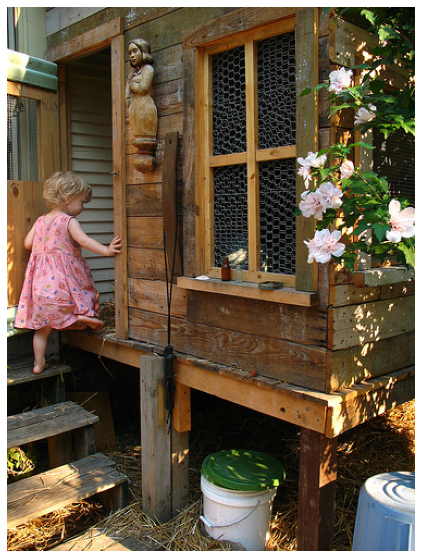

Two dogs are playing with each other in the grass.


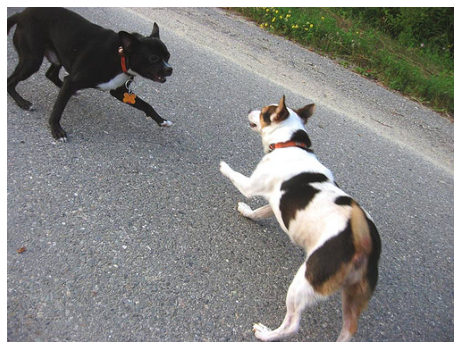

Girl in green dress and blue dress is sitting on the road.


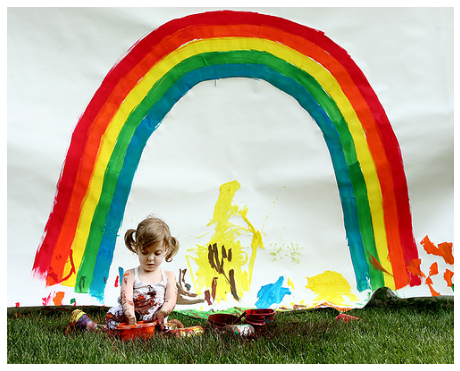

Man sitting on bench on bench.


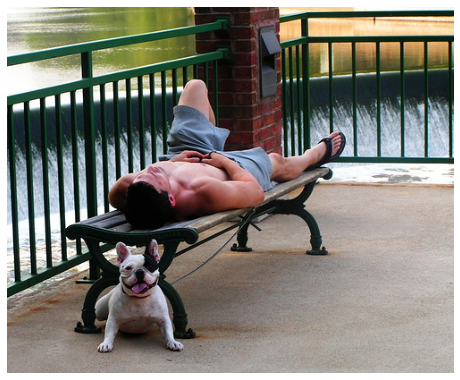

Man with mohawk and sunglasses and hat is wearing glasses.


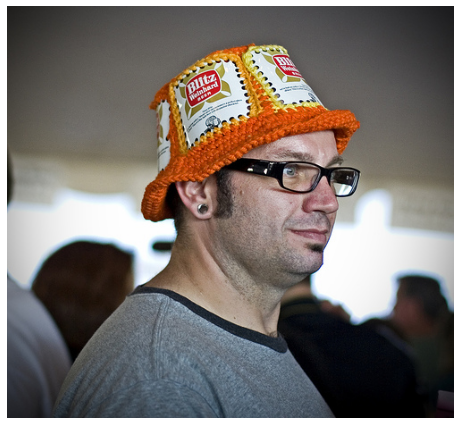

Little boy is playing in the playground.


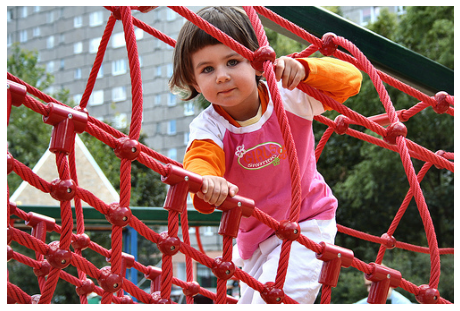

Dog jumps over the grass.


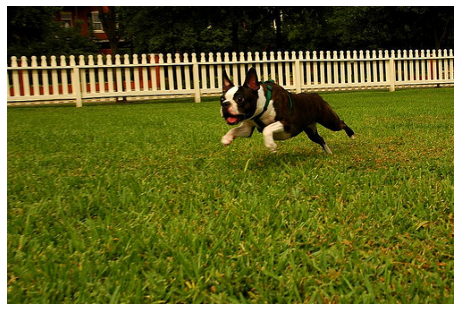

White dog with toy is playing in the water.


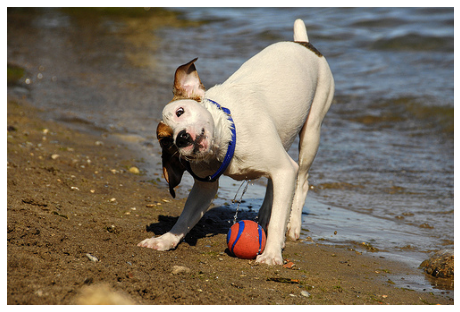

Woman in red and black and black and red jacket is walking down the street.


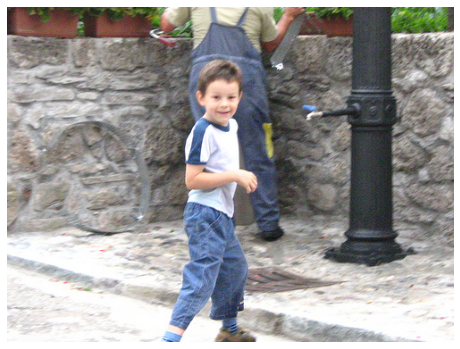

Black dog jumps over tree.


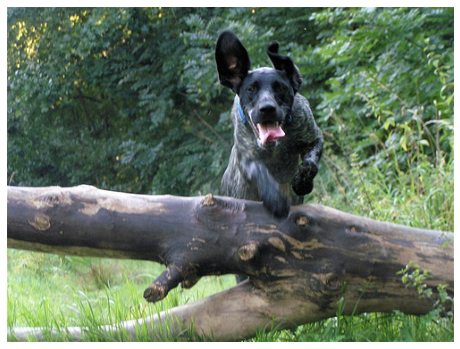

In [ ]:
checkpoint.restore('/Image Captioning/Model 6 Checkpoints/ckpt-5')

images_to_test = list(train_descriptions.keys())[:10]
image_dir = '/Image Captioning/Flicker8k_Dataset'

model = VGG16()
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)

for pic in images_to_test:
  ig = image_dir + '/' + pic + '.jpg'
  image = load_img(ig, target_size=(224,224))
  image = img_to_array(image)
  image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
  image = preprocess_input(image)
  features = model.predict(image,verbose=0)
  ig = mpimg.imread(ig)

  caption = generate_caption(features)
  caption = ' '.join(caption.split()[1:-1]).capitalize() + '.'
  print(caption)
  plt.figure(figsize=(8,10))
  plt.imshow(ig)
  plt.axis('off')
  plt.show()

The captions here are certainly a step in the wrong direction. While the model does an okay job of identifying the subjects of the images, it does a poor job when it comes to color descriptions. Though the young child's dress in the first image does have some blue spots, the dress is predominantly pink. Likewise, the color red really does not appear anywhere in the ninth image, save maybe on whatever object the person in the background is holding.

In [ ]:
evaluate_captions()

100%|██████████| 1000/1000 [03:13<00:00,  5.18it/s]


=================== Training ===================

BLEU-1: 0.543551
BLEU-2: 0.372622
BLEU-3: 0.249698
BLEU-4: 0.158796




100%|██████████| 1000/1000 [03:23<00:00,  4.91it/s]


=================== Testing ===================

BLEU-1: 0.409227
BLEU-2: 0.244242
BLEU-3: 0.145583
BLEU-4: 0.080455


These BLEU scores really do not offer much in the way of improvements, especially when it comes to the test sets. This seems to confirm the idea that a batch size of around 64 is most appropriate for training a model with this kind of architecture.